<a href="https://colab.research.google.com/github/Rohiniv17/FORE/blob/main/DLNLP/MidTerm%20/DLNLP_Project_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## DLNLP Project 2


#### Imports

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.impute import SimpleImputer
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.utils import plot_model

from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"


In [ ]:
pathToFolder = "/gdrive/MyDrive/bdda1/"
path = Path(pathToFolder) / "HR-Employee-Attrition.csv"

In [ ]:
df = pd.read_csv(path)
df.head()
df.shape
df.info()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


(1470, 35)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [ ]:
for i in df.columns:
  if df[i].dtype=='object':
    print(i)
    print(df[i].unique())

Attrition
['Yes' 'No']
BusinessTravel
['Travel_Rarely' 'Travel_Frequently' 'Non-Travel']
Department
['Sales' 'Research & Development' 'Human Resources']
EducationField
['Life Sciences' 'Other' 'Medical' 'Marketing' 'Technical Degree'
 'Human Resources']
Gender
['Female' 'Male']
JobRole
['Sales Executive' 'Research Scientist' 'Laboratory Technician'
 'Manufacturing Director' 'Healthcare Representative' 'Manager'
 'Sales Representative' 'Research Director' 'Human Resources']
MaritalStatus
['Single' 'Married' 'Divorced']
Over18
['Y']
OverTime
['Yes' 'No']


In [ ]:
df['target'] = df.Attrition.apply(lambda x: 1 if x=="Yes" else 0)
df['Traveller'] = df.BusinessTravel.apply(lambda x: 0 if x=='Non-Travel' else( 1 if x=='Travel_Rarely' else 2))
df['Male'] = df.Gender.apply(lambda x: 1 if x=='Male' else 0)
df['OverTime_code'] = df.OverTime.apply(lambda x: 1 if x=="Yes" else 0)

In [ ]:
df_coded = pd.get_dummies(df, columns = ['Department', 'EducationField',\
                                         'MaritalStatus', 'JobRole'])
df_coded.drop(['Attrition', 'BusinessTravel', 'Gender', 'OverTime', 'Over18',\
                'MaritalStatus_Single', 'EducationField_Other',\
                'JobRole_Manager'], axis=1, inplace = True)
df_coded

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,MaritalStatus_Divorced,MaritalStatus_Married,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative
0,41,1102,1,2,1,1,2,94,3,2,...,0,0,0,0,0,0,0,0,1,0
1,49,279,8,1,1,2,3,61,2,2,...,0,1,0,0,0,0,0,1,0,0
2,37,1373,2,2,1,4,4,92,2,1,...,0,0,0,0,1,0,0,0,0,0
3,33,1392,3,4,1,5,4,56,3,1,...,0,1,0,0,0,0,0,1,0,0
4,27,591,2,1,1,7,1,40,3,1,...,0,1,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,884,23,2,1,2061,3,41,4,2,...,0,1,0,0,1,0,0,0,0,0
1466,39,613,6,1,1,2062,4,42,2,3,...,0,1,1,0,0,0,0,0,0,0
1467,27,155,4,3,1,2064,2,87,4,2,...,0,1,0,0,0,1,0,0,0,0
1468,49,1023,2,3,1,2065,4,63,2,2,...,0,1,0,0,0,0,0,0,1,0


In [ ]:
df_coded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 48 columns):
 #   Column                             Non-Null Count  Dtype
---  ------                             --------------  -----
 0   Age                                1470 non-null   int64
 1   DailyRate                          1470 non-null   int64
 2   DistanceFromHome                   1470 non-null   int64
 3   Education                          1470 non-null   int64
 4   EmployeeCount                      1470 non-null   int64
 5   EmployeeNumber                     1470 non-null   int64
 6   EnvironmentSatisfaction            1470 non-null   int64
 7   HourlyRate                         1470 non-null   int64
 8   JobInvolvement                     1470 non-null   int64
 9   JobLevel                           1470 non-null   int64
 10  JobSatisfaction                    1470 non-null   int64
 11  MonthlyIncome                      1470 non-null   int64
 12  MonthlyRate         

In [ ]:
def count_plotter_1(df, column):
  Counts = df[column].value_counts().to_frame()
  Counts.rename(columns={column: 'value_counts'}, inplace=True)

  labels = Counts.index
  sizes = Counts['value_counts']

  plt.pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90)
  plt.axis('equal')  # Equal aspect ratio ensures a circular pie
  plt.title(column)

  plt.show()

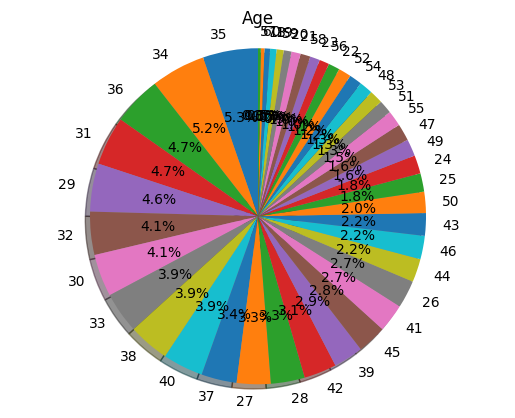

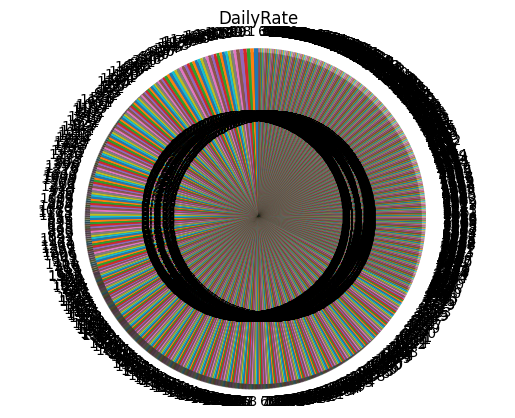

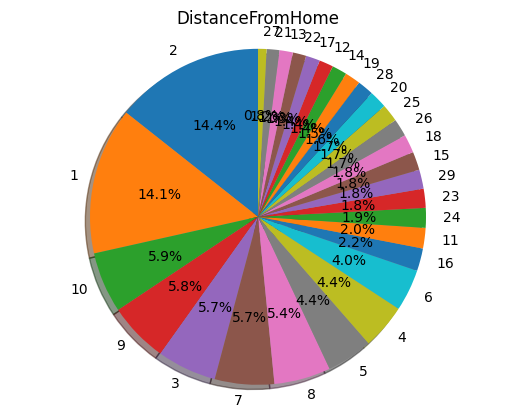

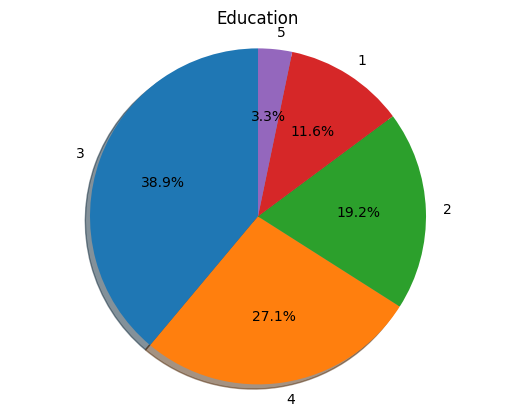

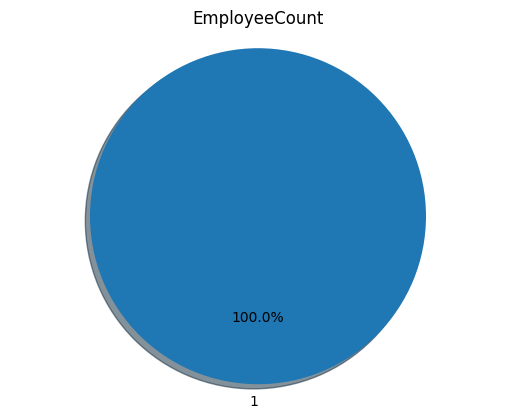

...

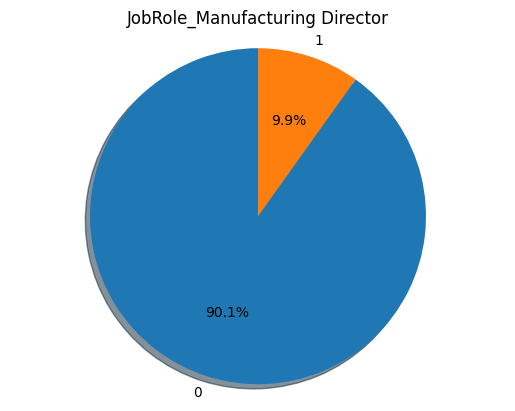

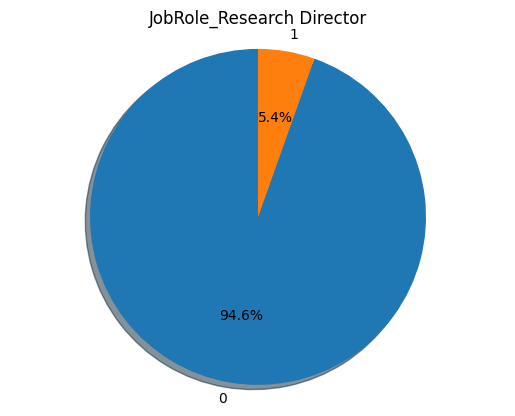

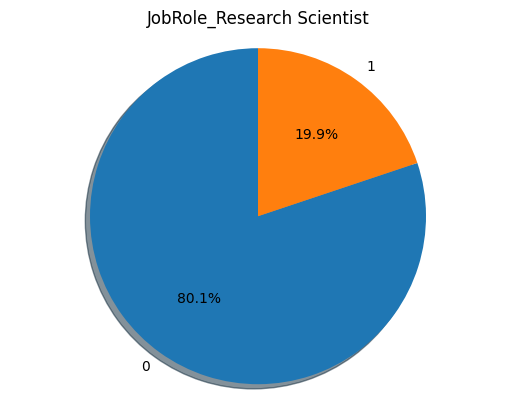

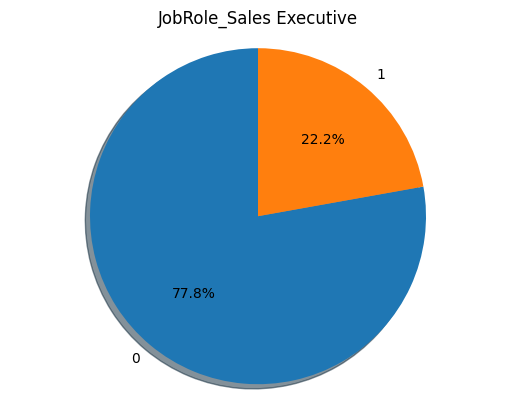

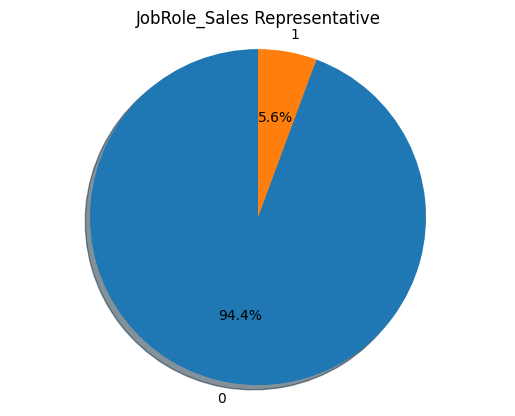

In [ ]:

for i in df_coded.columns:
  count_plotter_1(df_coded, i)

In [ ]:
df_coded.drop(['EmployeeNumber', 'EmployeeCount', 'StandardHours'], axis=1, inplace = True)

In [ ]:
def pivot_plotter_1(df_temp, i, k):
    grouped = df_temp.groupby(i).mean()

    plt.style.use('ggplot')

    # Create a bar plot
    grouped.plot(kind='bar', figsize=(10, 6))

    # Set the title and labels for the plot
    plt.title(i +' and Mean '+k )
    plt.xlabel(i)
    plt.ylabel('Mean '+k)
    #plt.xticks(grouped_test16.index.tolist())

    # Show the plot
    plt.show()

In [ ]:

non_cat = ['Age', 'DistanceFromHome', 'HourlyRate', 'DailyRate', 'MonthlyRate',\
           'MonthlyIncome', 'NumCompaniesWorked', 'PercentSalaryHike',\
           'PerformanceRating', 'TotalWorkingYears', 'TrainingTimesLastYear',\
           'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

cat = [e for e in df_coded.columns.tolist() if e not in non_cat]

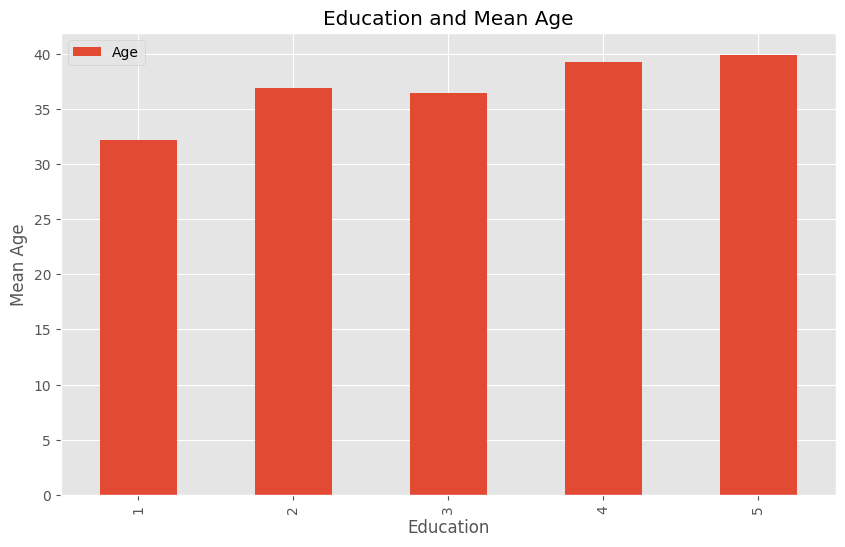

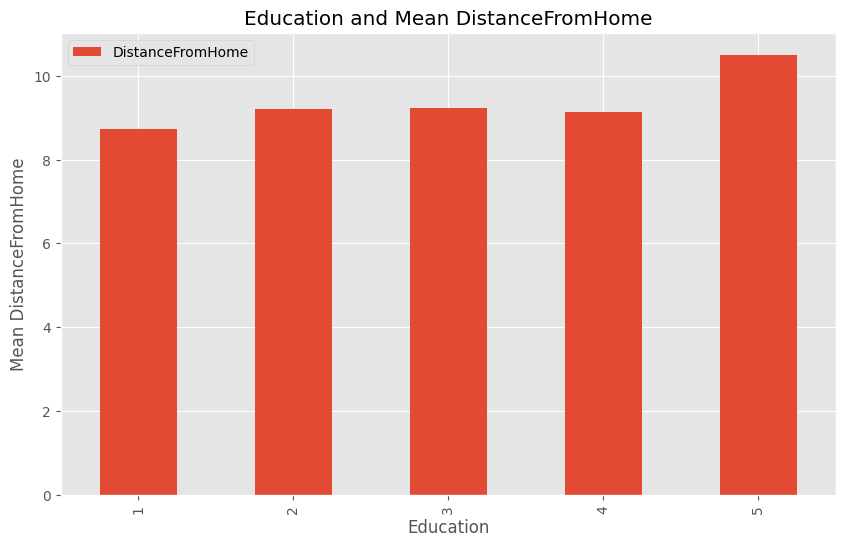

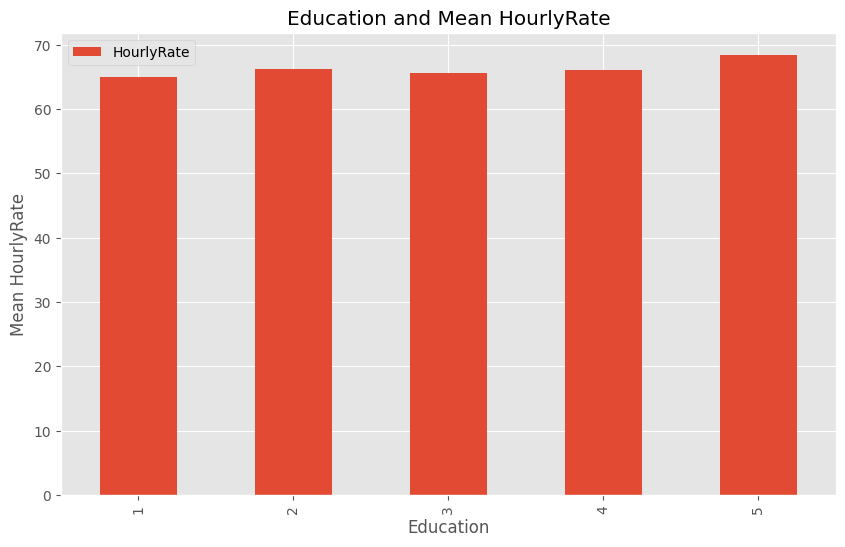

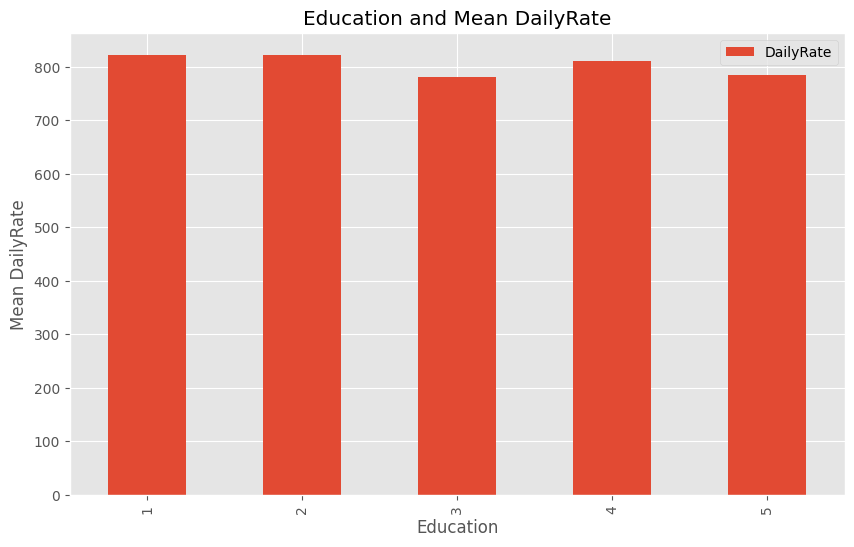

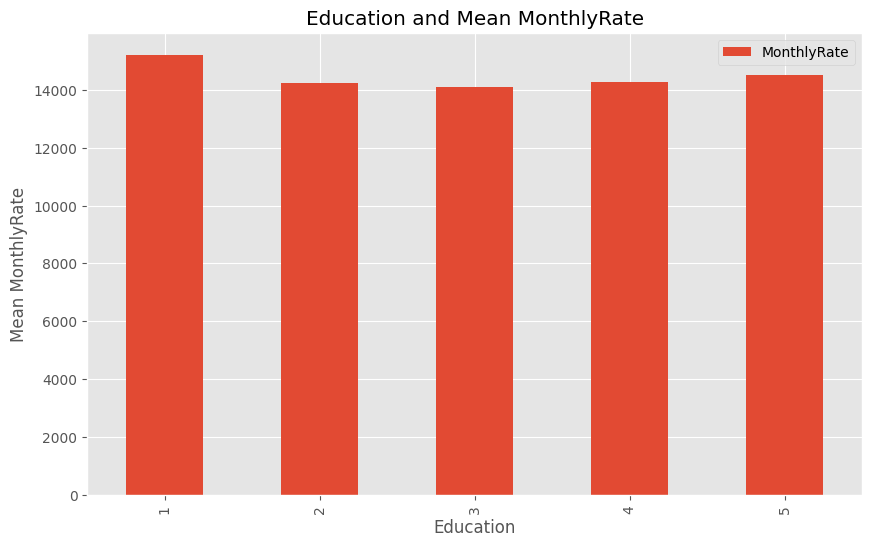

...

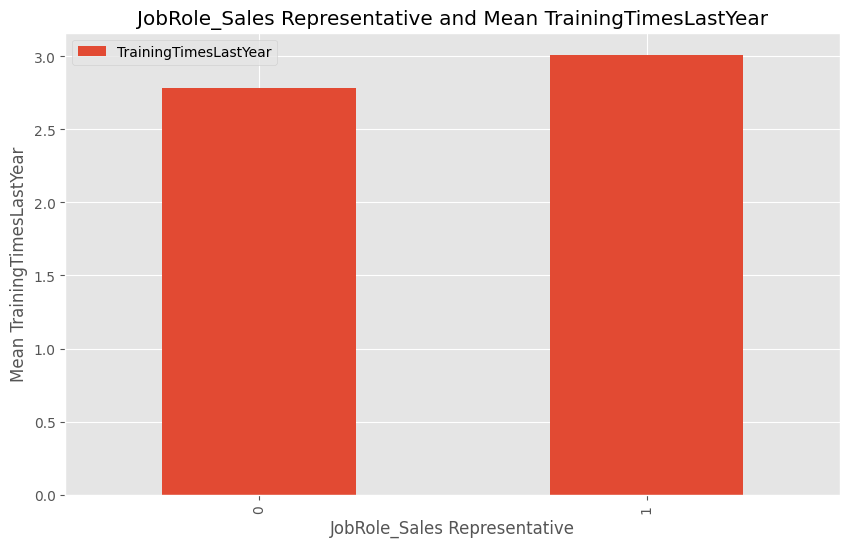

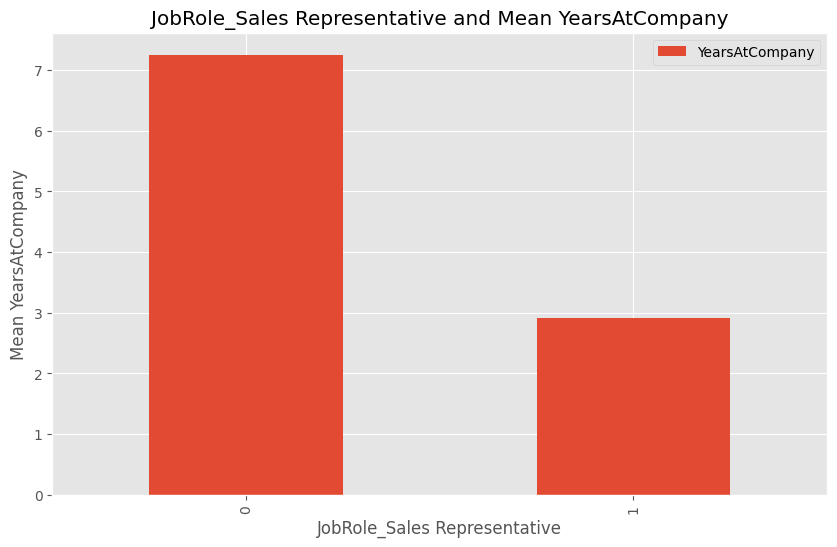

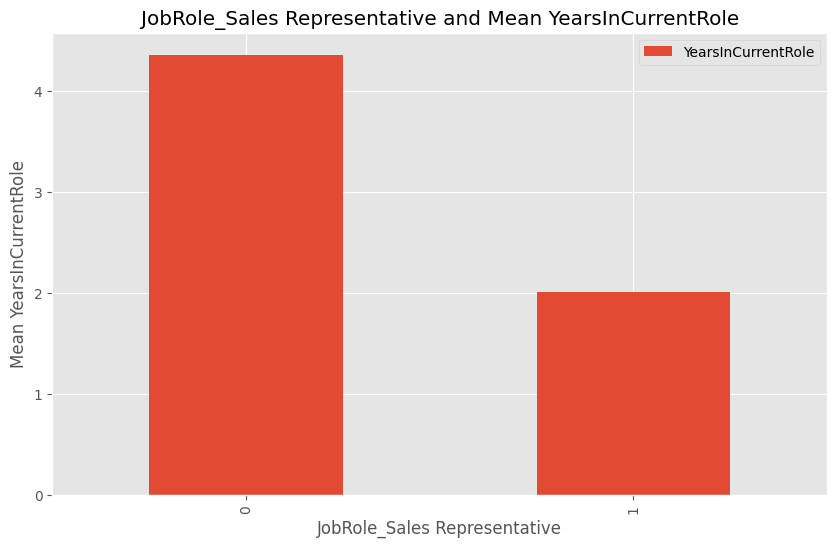

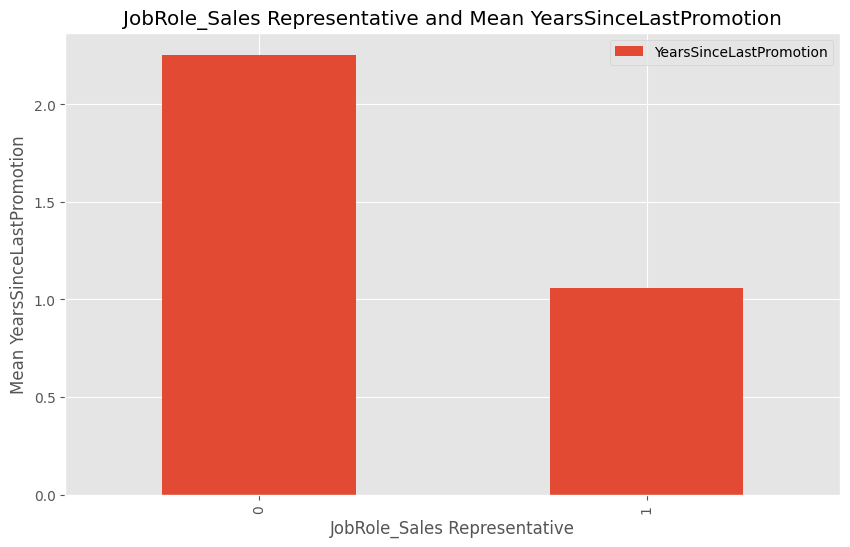

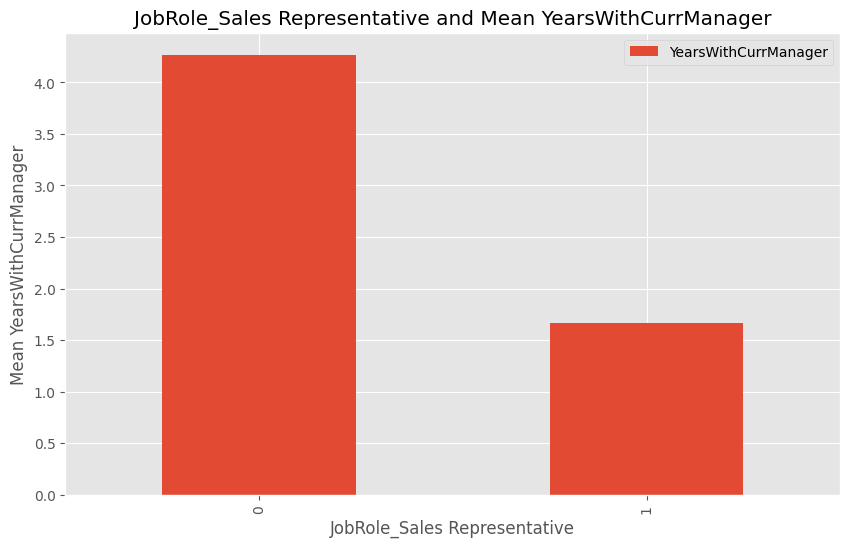

In [ ]:

for i in cat:
  for j in non_cat:
      pivot_plotter_1(df_coded[[i, j]], i, j)

In [ ]:
def x_y_plot(x, y):
    plt.style.use('ggplot')
    plt.scatter(x,y)
    plt.title(x.name +' vs '+y.name )
    plt.xlabel(x.name)
    plt.ylabel(y.name)
    plt.show()

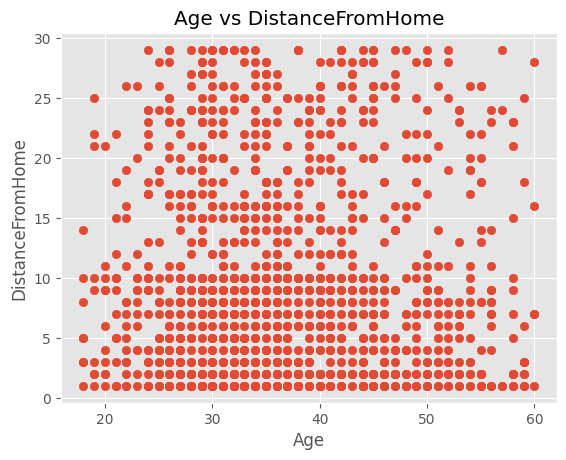

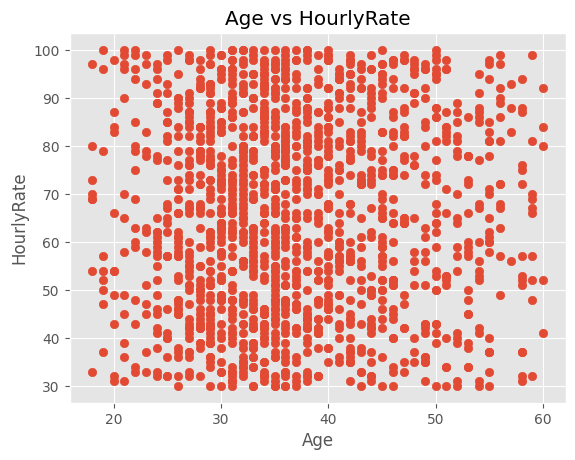

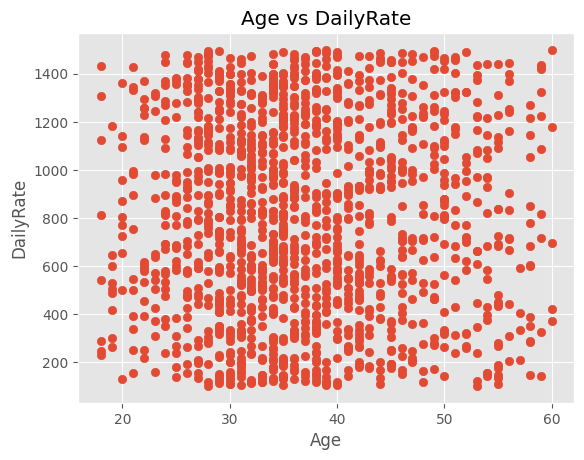

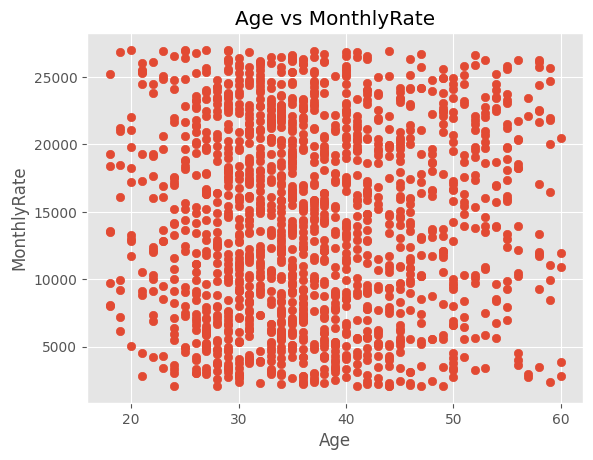

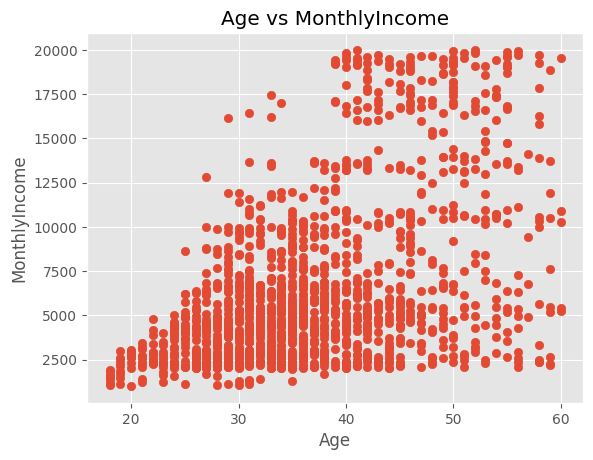

...

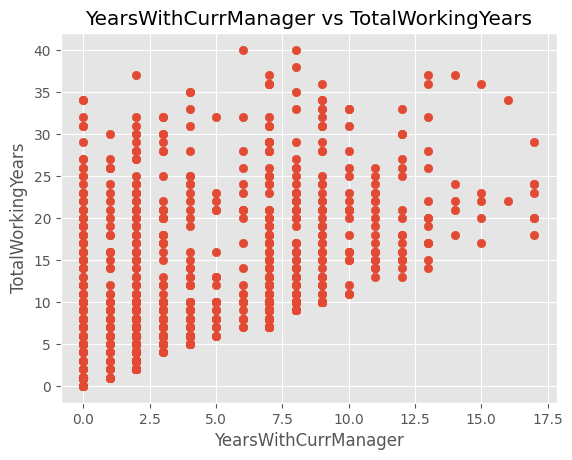

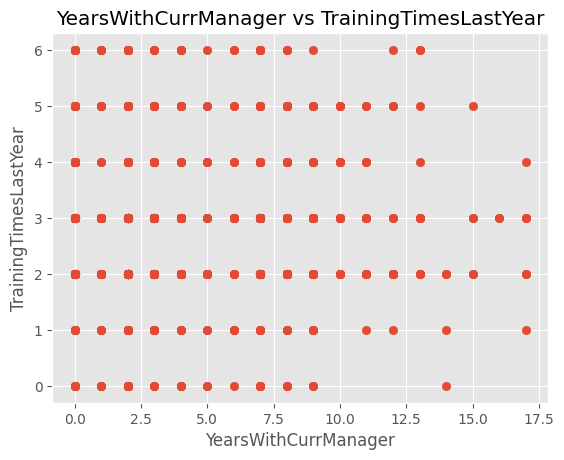

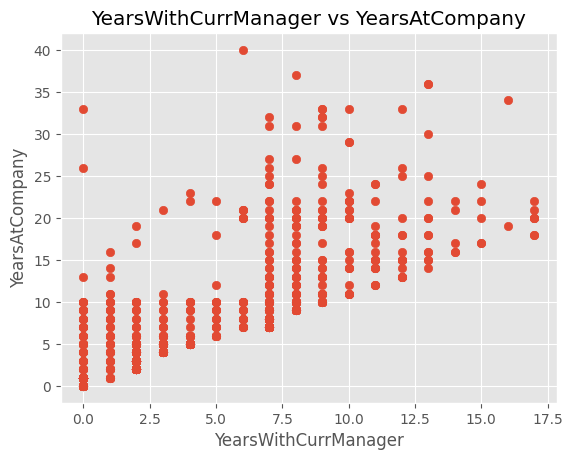

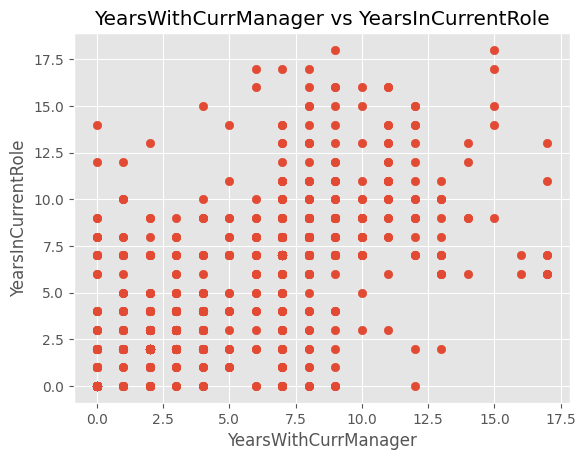

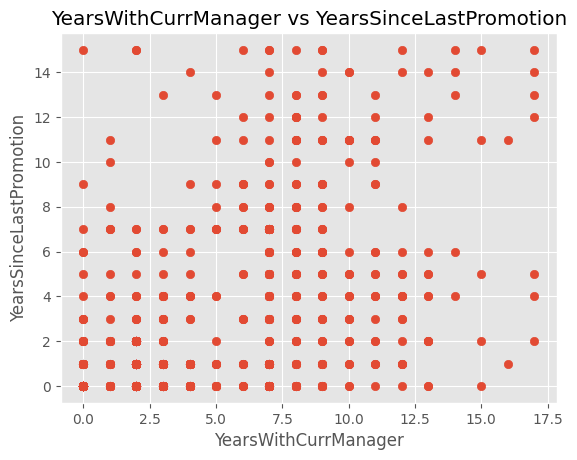

In [ ]:
for i in non_cat:
  for j in non_cat:
    if i!=j:
        x_y_plot(df[i], df[j])

In [ ]:
y = df.pop('target')

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df_coded, y, test_size=0.25)

In [ ]:
columns = X_train.columns.tolist()
scaler = MinMaxScaler().fit(X_train)

X_train = pd.DataFrame(scaler.transform(X_train), columns=columns).astype('float32')
X_test = pd.DataFrame(scaler.transform(X_test), columns=columns).astype('float32')

In [ ]:
X_train.shape

(1102, 45)

#### Model

In [ ]:
model = tf.keras.Sequential()


In [ ]:
model.add( tf.keras.layers.Input(shape = (45,) ))



In [ ]:
model.add(tf.keras.layers.Dense(256, activation = 'relu'))

In [ ]:
model.add(tf.keras.layers.Dense(512, activation = 'relu'))

In [ ]:
model.add(tf.keras.layers.Dense(256, activation = 'relu'))

In [ ]:
model.add(tf.keras.layers.Dense(64, activation = 'relu'))

In [ ]:
model.add(tf.keras.layers.Dense(1, activation = 'sigmoid'))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               11776     
                                                                 
 dense_1 (Dense)             (None, 512)               131584    
                                                                 
 dense_2 (Dense)             (None, 256)               131328    
                                                                 
 dense_3 (Dense)             (None, 64)                16448     
                                                                 
 dense_4 (Dense)             (None, 1)                 65        
                                                                 
Total params: 291,201
Trainable params: 291,201
Non-trainable params: 0
_________________________________________________________________


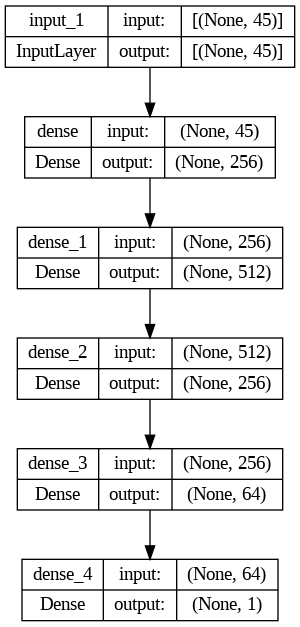

In [ ]:
model.summary()
plot_model(model, show_shapes=True)


In [ ]:
model.compile(
                 loss = 'binary_crossentropy',
                 optimizer = 'adam',
                 metrics = ['acc', 'mae']
              )

In [ ]:
history1 = model.fit(X_train,y_train,
                    epochs = 150,
                    validation_data = (X_test, y_test)
                   )

Epoch 1/150
35/35 [==============================] - 4s 27ms/step - loss: 0.2854 - acc: 0.8902 - mae: 0.1907 - val_loss: 0.0333 - val_acc: 1.0000 - val_mae: 0.0291
Epoch 2/150
35/35 [==============================] - 1s 16ms/step - loss: 0.0052 - acc: 0.9982 - mae: 0.0045 - val_loss: 2.4890e-04 - val_acc: 1.0000 - val_mae: 2.4733e-04
Epoch 3/150
35/35 [==============================] - 1s 15ms/step - loss: 9.7135e-05 - acc: 1.0000 - mae: 9.7038e-05 - val_loss: 8.4306e-05 - val_acc: 1.0000 - val_mae: 8.4150e-05
Epoch 4/150
35/35 [==============================] - 0s 9ms/step - loss: 2.2533e-05 - acc: 1.0000 - mae: 2.2530e-05 - val_loss: 2.1483e-05 - val_acc: 1.0000 - val_mae: 2.1479e-05
Epoch 5/150
35/35 [==============================] - 0s 11ms/step - loss: 1.2661e-05 - acc: 1.0000 - mae: 1.2660e-05 - val_loss: 1.4865e-05 - val_acc: 1.0000 - val_mae: 1.4863e-05
Epoch 6/150
35/35 [==============================] - 0s 11ms/step - loss: 9.1358e-06 - acc: 1.0000 - mae: 9.1355e-06 - val_lo

(0.0, 1e-05)

Text(0.5, 1.0, 'Change in loss over epochs')

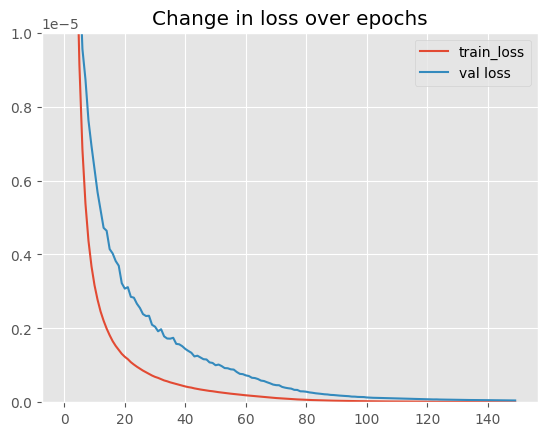

In [ ]:
loss = history1.history['loss']
val_loss = history1.history['val_loss']
plt.plot(loss, label = "train_loss")
plt.plot(val_loss, label = "val loss")
plt.legend()
plt.ylim([0, 0.00001])
plt.title('Change in loss over epochs')

In [ ]:
df_weights = pd.DataFrame(model.layers[0].weights[0]); df_weights

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
0,0.013987,0.049102,0.125121,0.065012,0.139649,-0.092396,0.058474,0.110740,0.034888,-0.049074,...,0.108950,-0.044449,0.093168,-0.062138,-0.050147,0.115159,-0.084170,-0.043727,0.125364,-0.016716
1,-0.082092,0.040920,-0.062921,-0.080711,-0.091890,0.109736,-0.026745,-0.145450,0.091893,-0.034848,...,-0.107919,-0.030187,-0.037390,-0.141762,-0.073995,-0.009882,-0.014007,-0.054376,0.041706,-0.043690
2,0.099445,-0.056609,0.104187,0.108023,-0.084859,-0.012251,0.031173,-0.022223,0.050809,0.047674,...,-0.098775,-0.123690,-0.051755,0.064209,0.012140,-0.071428,0.144277,-0.029636,-0.036385,-0.091906
3,-0.115000,0.017714,-0.028156,0.043443,-0.027602,-0.048150,0.033521,0.046618,0.143367,0.070493,...,0.053913,-0.116107,-0.084934,-0.131630,-0.090781,0.137147,0.113424,0.012552,0.116227,0.118061
4,-0.053917,-0.051470,-0.062507,0.005753,0.100137,-0.027816,-0.001279,0.028984,-0.006003,0.046339,...,0.070439,-0.092355,-0.104336,0.043342,-0.049840,0.003672,0.151579,-0.076018,0.089880,0.052841
5,0.054313,0.063624,-0.091945,-0.075045,-0.073826,-0.092833,0.097459,-0.142501,0.118094,-0.087533,...,-0.094746,-0.133529,0.015632,0.002260,0.004346,0.024678,0.029757,0.049742,0.058431,0.119459
6,-0.103333,0.048919,0.098609,0.114043,0.128019,0.074896,-0.104567,-0.041859,-0.098028,-0.064239,...,0.035050,0.112189,-0.102629,0.035038,0.072220,-0.072979,0.128937,0.100904,-0.089418,-0.013618
7,0.147642,0.041314,-0.060755,-0.007073,0.071064,-0.083678,0.111790,-0.100274,0.007629,-0.041010,...,-0.013577,0.057961,0.049951,-0.014699,0.116239,0.015501,-0.081605,-0.101115,-0.005102,-0.121909
8,0.122621,0.001881,-0.027044,0.107464,0.110336,-0.005550,0.030389,0.023782,-0.105727,-0.082456,...,0.140723,-0.072664,0.138370,-0.097684,0.010399,0.106086,-0.079731,0.100727,0.029028,-0.044543
9,-0.024169,0.102519,0.121524,-0.060231,0.013769,0.113434,0.077457,0.077792,0.002462,-0.053108,...,-0.119721,0.083431,0.062846,0.013066,-0.128628,0.121319,0.079072,0.110169,0.124738,-0.132630


12/12 [==============================] - 0s 3ms/step


<Axes: >

Text(0.5, 23.52222222222222, 'Predicted Label')

Text(50.722222222222214, 0.5, 'True Label')

Text(0.5, 1.0, 'Confusion Matrix')

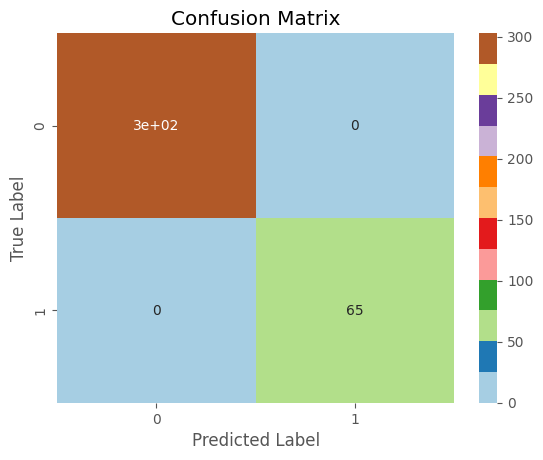

In [ ]:
predictions = model.predict(X_test)
ax = plt.axes()
sns.heatmap(confusion_matrix( y_test,predictions.round(0) ), annot=True, cmap='Paired')
ax.set_xlabel('Predicted Label')
ax.set_ylabel('True Label')
ax.set_title('Confusion Matrix')
plt.show()

array([[1.64295157e-11],
       [1.61130310e-11],
       [1.25265617e-10],
       [8.91049875e-13],
       [1.62482952e-08],
       [2.10803208e-10],
       [6.00009209e-11],
       [5.30616662e-10],
       [1.00000000e+00],
       [1.29427968e-10],
       [3.24108540e-09],
       [1.20645949e-09],
       [8.47111492e-10],
       [4.42716211e-11],
       [2.24945351e-09],
       [6.25642760e-10],
       [4.63616345e-09],
       [7.31437549e-11],
       [2.82136048e-09],
       [1.36606026e-09],
       [9.99999225e-01],
       [2.92405401e-12],
       [4.08497021e-11],
       [2.88734725e-09],
       [3.25383276e-09],
       [1.14860610e-09],
       [8.03430780e-08],
       [1.00000000e+00],
       [1.76834762e-11],
       [2.71348014e-11],
       [3.36869005e-10],
       [1.92970107e-09],
       [3.72954867e-09],
       [4.00932846e-12],
       [1.00000000e+00],
       [2.08751419e-10],
       [1.00000000e+00],
       [9.33565655e-11],
       [7.01238442e-11],
       [6.19944485e-10],
